<a href="https://colab.research.google.com/github/thapaliya123/Coursera_Capstone/blob/master/data_understanding_preparation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#import libraries
import pandas as pd
import numpy as np
import random
import matplotlib.pyplot as plt

# Data Acquisition and Data Understanding  
_First Step is to acquire the datasets from different sources and load it into pandas dataframe._

Q.What is the problem that you are trying to solve (or prove wrong)?  
-> Can  we predict the accident severity due to collisions based on data?


In [ ]:
 #Using Wget command to save the downloaded file under different name, pass -O option followed by the choosen name
'''
-Meta Data Link:
 https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Metadata.pdf

-datasets refer by course instructor, only two class available, 1-injury, 0-property-damage:
 !wget -O Data-collisions.csv "https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Data-Collisions.csv"
'''
#
# 

#datasets containing five class, 0-unknown, 1-property damage, 2-injury, 2b-serious injury, 3-fatality 
!wget -O Data-collisions.csv "http://data-seattlecitygis.opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.csv"



--2020-10-17 01:42:58--  http://data-seattlecitygis.opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.csv
Resolving data-seattlecitygis.opendata.arcgis.com (data-seattlecitygis.opendata.arcgis.com)... 52.7.217.80, 3.219.100.202, 35.170.42.12, ...
Connecting to data-seattlecitygis.opendata.arcgis.com (data-seattlecitygis.opendata.arcgis.com)|52.7.217.80|:80... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://data-seattlecitygis.opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.csv [following]
--2020-10-17 01:42:58--  https://data-seattlecitygis.opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.csv
Connecting to data-seattlecitygis.opendata.arcgis.com (data-seattlecitygis.opendata.arcgis.com)|52.7.217.80|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘Data-collisions.csv’

Data-collisions.csv     [             <=>    ]  81.10M  26.4MB/s    in 3.

In [ ]:
#load datasets
collision_df = pd.read_csv("Data-collisions.csv")

#set "OBJECTID" column as index of dataframe and set index name to "ID"
collision_df.set_index('OBJECTID', inplace=True)
collision_df.index.name = 'ID'

#top five data from dataframe
collision_df.head()

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,-122.356511,47.517361,327920,329420,3856094,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,,NaN,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Dry,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
2,-122.361405,47.702064,46200,46200,1791736,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,NaN,NaN,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0,Raining,Wet,Dusk,NaN,5101020.0,NaN,13,From same direction - both going straight - bo...,0,0,N
3,-122.317414,47.664028,1212,1212,3507861,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,,NaN,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Dry,Dark - Street Lights On,NaN,NaN,NaN,30,From opposite direction - all others,0,0,N
4,-122.318234,47.619927,327909,329409,EA03026,Matched,Intersection,29054.0,11TH AVE E AND E JOHN ST,,NaN,2,Injury Collision,Pedestrian,3,1,0,1,1,0,0,2020/01/06 00:00:00+00,1/6/2020 5:55:00 PM,At Intersection (intersection related),24.0,MOTOR VEHCILE STRUCK PEDESTRIAN,NaN,N,Raining,Wet,Dark - Street Lights On,NaN,NaN,NaN,0,Vehicle going straight hits pedestrian,0,0,N
5,-122.351724,47.560306,104900,104900,2671936,Matched,Block,NaN,WEST MARGINAL WAY SW BETWEEN SW ALASKA ST AND ...,NaN,NaN,2,Injury Collision,Other,2,0,0,1,1,0,0,2009/12/25 00:00:00+00,12/25/2009 7:00:00 PM,Mid-Block (not related to intersection),28.0,MOTOR VEHICLE RAN OFF ROAD - HIT FIXED OBJECT,NaN,0,Clear,Ice,Dark - Street Lights On,NaN,9359012.0,Y,50,Fixed object,0,0,N


In [ ]:
#Get insights about datatypes of Variable
collision_df.dtypes

X                  float64
Y                  float64
INCKEY               int64
COLDETKEY            int64
REPORTNO            object
STATUS              object
ADDRTYPE            object
INTKEY             float64
LOCATION            object
EXCEPTRSNCODE       object
EXCEPTRSNDESC       object
SEVERITYCODE        object
SEVERITYDESC        object
COLLISIONTYPE       object
PERSONCOUNT          int64
PEDCOUNT             int64
PEDCYLCOUNT          int64
VEHCOUNT             int64
INJURIES             int64
SERIOUSINJURIES      int64
FATALITIES           int64
INCDATE             object
INCDTTM             object
JUNCTIONTYPE        object
SDOT_COLCODE       float64
SDOT_COLDESC        object
INATTENTIONIND      object
UNDERINFL           object
WEATHER             object
ROADCOND            object
LIGHTCOND           object
PEDROWNOTGRNT       object
SDOTCOLNUM         float64
SPEEDING            object
ST_COLCODE          object
ST_COLDESC          object
SEGLANEKEY           int64
C

In [ ]:
#descriptive statistics of datasets, provide summary statistics, excluding NaN (Not a Number) values, by default includes continuous data
collision_df.describe()

,X,Y,INCKEY,COLDETKEY,INTKEY,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,SDOT_COLCODE,SDOTCOLNUM,SEGLANEKEY,CROSSWALKKEY
count,214260.000000,214260.000000,221738.000000,221738.000000,72027.000000,221738.000000,221738.000000,221738.000000,221738.000000,221738.000000,221738.000000,221738.000000,221737.000000,1.272050e+05,221738.000000,2.217380e+05
mean,-122.330753,47.620191,145006.735517,145236.969811,37636.986713,2.226741,0.038095,0.027352,1.729442,0.373964,0.015203,0.001700,13.383305,7.971063e+06,262.624791,9.568044e+03
std,0.030058,0.056059,89372.351774,89749.554004,52000.820955,1.469699,0.201704,0.164512,0.830529,0.732050,0.158004,0.044967,7.298289,2.611523e+06,3252.882590,7.142784e+04
min,-122.419091,47.495573,1001.000000,1001.000000,23807.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.007024e+06,0.000000,0.000000e+00
25%,-122.349280,47.577106,71721.250000,71721.250000,28653.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,11.000000,6.007029e+06,0.000000,0.000000e+00
50%,-122.330363,47.616033,127358.500000,127358.500000,29973.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,11.000000,8.033011e+06,0.000000,0.000000e+00
75%,-122.311998,47.664290,210118.750000,210338.750000,33984.000000,3.000000,0.000000,0.000000,2.000000,1.000000,0.000000,0.000000,14.000000,1.018101e+07,0.000000,0.000000e+00
max,-122.238949,47.734142,334276.000000,335776.000000,764413.000000,93.000000,6.000000,2.000000,15.000000,78.000000,41.000000,5.000000,87.000000,1.307202e+07,525241.000000,5.239700e+06


In [ ]:
#descriptive statistics, for categorical variable i.e. ["ADDRTYPE", "SEVERITYCODE", "SEVERITYDESC", "COLLISIONTYPE", "JUNCTIONTYPE",\
#                                 "INATTENTIONIND", "UNDERINFL", "WEATHER", "ROADCOND", "LIGHTCOND", "PEDROWNOTGRNT", "SPEEDING"]
collision_df[["ADDRTYPE", "SEVERITYCODE", "SEVERITYDESC", "COLLISIONTYPE", "JUNCTIONTYPE", "INATTENTIONIND", "UNDERINFL", "WEATHER", "ROADCOND", "LIGHTCOND", "PEDROWNOTGRNT", "SPEEDING"]].describe()

,ADDRTYPE,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,JUNCTIONTYPE,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SPEEDING
count,218024,221737,221738,195287,209759,30188,195307,195097,195178,195008,5195,9936
unique,3,5,5,10,7,1,4,12,9,9,1,1
top,Block,1,Property Damage Only Collision,Parked Car,Mid-Block (not related to intersection),Y,N,Clear,Dry,Daylight,Y,Y
freq,145118,137776,137776,48558,101823,30188,104002,114807,128660,119555,5195,9936


In [ ]:
#descriptive statistics, all columns in dataframe
collision_df.describe(include='all')

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
count,214260.000000,214260.000000,221738.000000,221738.000000,221738,221738,218024,72027.000000,217145,101335,11785,221737,221738,195287,221738.000000,221738.000000,221738.000000,221738.000000,221738.000000,221738.000000,221738.000000,221738,221738,209759,221737.000000,221737,30188,195307,195097,195178,195008,5195,1.272050e+05,9936,212325,195287,221738.000000,2.217380e+05,221738
unique,NaN,NaN,NaN,NaN,221735,2,3,NaN,25209,2,1,5,5,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6109,169669,7,NaN,40,1,4,12,9,9,1,NaN,1,63,62,NaN,NaN,2
top,NaN,NaN,NaN,NaN,1780512,Matched,Block,NaN,BATTERY ST TUNNEL NB BETWEEN ALASKAN WY VI NB ...,,"Not Enough Information, or Insufficient Locati...",1,Property Damage Only Collision,Parked Car,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2006/11/02 00:00:00+00,11/2/2006,Mid-Block (not related to intersection),NaN,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",Y,N,Clear,Dry,Daylight,Y,NaN,Y,32,One parked--one moving,NaN,NaN,N
freq,NaN,NaN,NaN,NaN,2,195360,145118,NaN,298,89550,11785,137776,137776,48558,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103,103,101823,NaN,92182,30188,104002,114807,128660,119555,5195,NaN,9936,44937,44937,NaN,NaN,209649
mean,-122.330753,47.620191,145006.735517,145236.969811,NaN,NaN,NaN,37636.986713,NaN,NaN,NaN,NaN,NaN,NaN,2.226741,0.038095,0.027352,1.729442,0.373964,0.015203,0.001700,NaN,NaN,NaN,13.383305,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.971063e+06,NaN,NaN,NaN,262.624791,9.568044e+03,NaN
std,0.030058,0.056059,89372.351774,89749.554004,NaN,NaN,NaN,52000.820955,NaN,NaN,NaN,NaN,NaN,NaN,1.469699,0.201704,0.164512,0.830529,0.732050,0.158004,0.044967,NaN,NaN,NaN,7.298289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.611523e+06,NaN,NaN,NaN,3252.882590,7.142784e+04,NaN
min,-122.419091,47.495573,1001.000000,1001.000000,NaN,NaN,NaN,23807.000000,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.007024e+06,NaN,NaN,NaN,0.000000,0.000000e+00,NaN
25%,-122.349280,47.577106,71721.250000,71721.250000,NaN,NaN,NaN,28653.000000,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,11.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.007029e+06,NaN,NaN,NaN,0.000000,0.000000e+00,NaN
50%,-122.330363,47.616033,127358.500000,127358.500000,NaN,NaN,NaN,29973.000000,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,11.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.033011e+06,NaN,NaN,NaN,0.000000,0.000000e+00,NaN
75%,-122.311998,47.664290,210118.750000,210338.750000,NaN,NaN,NaN,33984.000000,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,0.000000,0.000000,2.000000,1.000000,0.000000,0.000000,NaN,NaN,NaN,14.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.018101e+07,NaN,NaN,NaN,0.000000,0.000000e+00,NaN


In [ ]:
#Get basic information about dataframe
collision_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 221738 entries, 1 to 221738
Data columns (total 39 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   X                214260 non-null  float64
 1   Y                214260 non-null  float64
 2   INCKEY           221738 non-null  int64  
 3   COLDETKEY        221738 non-null  int64  
 4   REPORTNO         221738 non-null  object 
 5   STATUS           221738 non-null  object 
 6   ADDRTYPE         218024 non-null  object 
 7   INTKEY           72027 non-null   float64
 8   LOCATION         217145 non-null  object 
 9   EXCEPTRSNCODE    101335 non-null  object 
 10  EXCEPTRSNDESC    11785 non-null   object 
 11  SEVERITYCODE     221737 non-null  object 
 12  SEVERITYDESC     221738 non-null  object 
 13  COLLISIONTYPE    195287 non-null  object 
 14  PERSONCOUNT      221738 non-null  int64  
 15  PEDCOUNT         221738 non-null  int64  
 16  PEDCYLCOUNT      221738 non-null  int6

From above we can see and understand different numerical and categorical variable present in our datasets.   

Another amazing library to understand and get insight into datsets is **Pandas Profiling**, Lets explore our datasets using it,

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

from pandas_profiling import ProfileReport

profile = ProfileReport(collision_df, title="Collision Dataset", html={'style': {'full_width': True}})
profile.to_notebook_iframe()

     - 43.8MB 1.6MB/s
     |████████████████████████████████| 71kB 3.9MB/s 
     |████████████████████████████████| 71kB 5.6MB/s 
     |████████████████████████████████| 604kB 9.7MB/s 
     |████████████████████████████████| 3.1MB 22.4MB/s 
     |████████████████████████████████| 71kB 7.3MB/s 
     |████████████████████████████████| 296kB 64.1MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.9.0-py2.py3-none-any.whl size=258952 sha256=84d124087dbde96801d183af7c641d35a5fc2a3609d75df28e5f385268b225da
  Stored in directory: /tmp/pip-ephem-wheel-cache-7otrq9uy/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=1491afd6783a22092575a599899e50426a6e8be956cca7d41d6921896a53e4d0
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for imagehash: filename=ImageHash-4.1.0-py2.py3-none-any.whl size=29199

Amazing, pandas profiling gives a lot more details and helps to understand the underlying nature of our datasets.  
From above report we can see that,   
- Number of variables=40  
- Number of observations=221738  
- Missing cells = 1398417  
- Duplicate rows = 0  

Also, there are mainly three types of variable i.e.  
1. Categorical: 30   
2. Numerical: 16  
3. Boolean: 1

On Exploring Data further, we have found that,   
- Feature **UNDERINFL** contains following unique values:  
  - 'N', '0', nan, '1', 'Y'

In [ ]:
#check unique values in UNDERINFL
collision_df['UNDERINFL'].unique()

array(['N', '0', nan, '1', 'Y'], dtype=object)

Here 'N' and '0' are same. Also, 'Y' and '1' are same. So,
- Replace 'N' and '0' by integer 0.  
  -  **0** indicates no influence of drugs or alcohol   
- Replace 'Y' and '1' by integer 1.  
  - **1** indicates under the influence of drugs or alcohol

In [ ]:
#replace values
collision_df["UNDERINFL"].replace(to_replace=['N', '0', '1', 'Y'], value=[0, 0, 1, 1], inplace=True)

#verify values
collision_df["UNDERINFL"].value_counts()

0.0    185678
1.0      9629
Name: UNDERINFL, dtype: int64

Also, **WEATHER**, **ROADCOND**, **LIGHTCOND** feature contains Unknown and Other fields:
  - Let us replace Unkown and Other by NaN


In [ ]:
#Check Unique Values
attr_list = ["WEATHER", "ROADCOND", "LIGHTCOND"]
for attr in attr_list:
  print("{}-Unique Values".format(attr))
  print(collision_df[attr].unique())
  print("\n")

WEATHER-Unique Values
['Clear' 'Raining' 'Overcast' nan 'Unknown' 'Other' 'Snowing'
 'Sleet/Hail/Freezing Rain' 'Fog/Smog/Smoke' 'Blowing Sand/Dirt'
 'Severe Crosswind' 'Partly Cloudy' 'Blowing Snow']


ROADCOND-Unique Values
['Dry' 'Wet' 'Ice' nan 'Unknown' 'Snow/Slush' 'Standing Water' 'Other'
 'Sand/Mud/Dirt' 'Oil']


LIGHTCOND-Unique Values
['Daylight' 'Dusk' 'Dark - Street Lights On' nan 'Unknown' 'Dawn'
 'Dark - No Street Lights' 'Dark - Street Lights Off' 'Other'
 'Dark - Unknown Lighting']




In [ ]:
#replace "unknown" by "Other" from WEATHER, ROADCOND, LIGHTCOND
for attr in attr_list:
  collision_df[attr].replace("Unknown", np.nan, inplace=True)
  collision_df[attr].replace("Other", np.nan, inplace=True)

In [ ]:
#Verify Unique Values
for attr in attr_list:
  print("**{}-Unique Values**".format(attr))
  print(collision_df[attr].unique())
  print("\n")

**WEATHER-Unique Values**
['Clear' 'Raining' 'Overcast' nan 'Snowing' 'Sleet/Hail/Freezing Rain'
 'Fog/Smog/Smoke' 'Blowing Sand/Dirt' 'Severe Crosswind' 'Partly Cloudy'
 'Blowing Snow']


**ROADCOND-Unique Values**
['Dry' 'Wet' 'Ice' nan 'Snow/Slush' 'Standing Water' 'Sand/Mud/Dirt' 'Oil']


**LIGHTCOND-Unique Values**
['Daylight' 'Dusk' 'Dark - Street Lights On' nan 'Dawn'
 'Dark - No Street Lights' 'Dark - Street Lights Off'
 'Dark - Unknown Lighting']




We can see _Unknown_, _Other_ is replaced by NaN from above result





# Data Wrangling
_Data Wrangling is the process of converting data from the initial format to a format that may be better for analysis._

Use the method head() to display the first five rows of the dataframe

In [ ]:
#To see what datasets looklike, we'll use the head() method
collision_df.head(20)

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,-122.356511,47.517361,327920,329420,3856094,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,,NaN,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0.0,Clear,Dry,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
2,-122.361405,47.702064,46200,46200,1791736,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,NaN,NaN,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0.0,Raining,Wet,Dusk,NaN,5101020.0,NaN,13,From same direction - both going straight - bo...,0,0,N
3,-122.317414,47.664028,1212,1212,3507861,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,,NaN,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0.0,Clear,Dry,Dark - Street Lights On,NaN,NaN,NaN,30,From opposite direction - all others,0,0,N
4,-122.318234,47.619927,327909,329409,EA03026,Matched,Intersection,29054.0,11TH AVE E AND E JOHN ST,,NaN,2,Injury Collision,Pedestrian,3,1,0,1,1,0,0,2020/01/06 00:00:00+00,1/6/2020 5:55:00 PM,At Intersection (intersection related),24.0,MOTOR VEHCILE STRUCK PEDESTRIAN,NaN,0.0,Raining,Wet,Dark - Street Lights On,NaN,NaN,NaN,0,Vehicle going straight hits pedestrian,0,0,N
5,-122.351724,47.560306,104900,104900,2671936,Matched,Block,NaN,WEST MARGINAL WAY SW BETWEEN SW ALASKA ST AND ...,NaN,NaN,2,Injury Collision,Other,2,0,0,1,1,0,0,2009/12/25 00:00:00+00,12/25/2009 7:00:00 PM,Mid-Block (not related to intersection),28.0,MOTOR VEHICLE RAN OFF ROAD - HIT FIXED OBJECT,NaN,0.0,Clear,Ice,Dark - Street Lights On,NaN,9359012.0,Y,50,Fixed object,0,0,N
6,-122.333067,47.544302,322205,323705,3694789,Matched,Block,NaN,1ST AV S NB OFF RP BETWEEN 1ST AV S BR NB AND ...,,NaN,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2019/08/08 00:00:00+00,8/8/2019 12:49:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",NaN,0.0,Clear,Dry,Daylight,NaN,NaN,NaN,14,From same direction - both going straight - on...,0,0,N
7,-122.338543,47.616874,322275,323775,E949282,Matched,Block,NaN,8TH AVE BETWEEN WESTLAKE AVE AND BLANCHARD ST,,NaN,1,Property Damage Only Collision,Cycles,3,0,1,1,0,0,0,2019/08/08 00:00:00+00,8/8/2019 8:57:00 AM,Mid-Block (not related to intersection),18.0,"MOTOR VEHICLE STRUCK PEDALCYCLIST, FRONT END A...",Y,0.0,Overcast,Dry,Daylight,NaN,NaN,NaN,5,Vehicle Strikes Pedalcyclist,0,0,N
8,NaN,NaN,5721,5721,1786583,Unmatched,NaN,NaN,NaN,NEI,"Not Enough Information, or Insufficient Locati...",1,Property Damage Only Collision,Parked Car,0,0,0,2,0,0,0,2007/08/27 00:00:00+00,8/27/2007,Mid-Block (not related to intersection),13.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, LEFT SIDE ...",NaN,0.0,Clear,Dry,Daylight,NaN,3239035.0,NaN,32,One parked--one moving,0,0,N
9,-122.360959,47.571594,33400,33400,1076890,Matched,Block,NaN,WEST SEATTLE BR WB BETWEEN W SEATTLE BR WB OFF...,NaN,NaN,2b,Serious Injury Collision,Rear Ended,3,0,0,3,3,1,0,2005/07/06 00:00:00+00,7/6/2005,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0.0,Clear,Dry,Daylight,NaN,5187041.0,NaN,13,From same direction - both going straight - bo...,0,0,N


As we can see, several "NaN" (which is python default missing value marker) and empty string(i.e." ") values appeared in the dataframe; those are missing values which may hinder further analysis.  
So, Dealing with those missing values is important.  

Steps for working with missing data:  
  1.Identify missing data  
  2.deal with missing data  
  3.correct data format


# Identify and handle missing values
**Identify missing values**  
Common Variety of missing data include:
  - Empty String, NA, N/A, None, -1 or 999.    

**Convert empty string(" ") to NaN (python default missing value marker)**  
In the seattle collision dataset, missing data comes with the empty string (i.e " ") especially in **_EXCEPTRSNCODE_** feature. We replace  " " with NaN (Not a Number), which is python's default missing value marker, which makes easy to handle missing data.  

.replace(A, B, inplace = True)  
to replace A by B

**SEVERITYDESC** variable contains **Unknown** data  
- Let us also convert "unknown" to **NaN**  

**JUNCTIONTYPE** variable contains **Unknown** data  
- Let us also convert "Unknown" to **NaN**  

Also, Target Variable i.e **SEVERITYCODE** contains '0' which represent **unkown** case  
- Let us also convert '0' in SEVERITYCODE to **NaN**


In [ ]:
#replace " " to NaN
collision_df.replace(" ", np.nan, inplace=True)

#replace "Unkown" to NaN from SEVERITYDESC
collision_df["SEVERITYDESC"].replace("Unknown", np.nan, inplace=True)
collision_df["JUNCTIONTYPE"].replace("Unknown", np.nan, inplace=True)

#replace "0" to NaN from SEVERITYCODE
collision_df['SEVERITYCODE'].replace('0', np.nan, inplace=True)

collision_df.head()

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,-122.356511,47.517361,327920,329420,3856094,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,NaN,NaN,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0.0,Clear,Dry,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
2,-122.361405,47.702064,46200,46200,1791736,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,NaN,NaN,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0.0,Raining,Wet,Dusk,NaN,5101020.0,NaN,13,From same direction - both going straight - bo...,0,0,N
3,-122.317414,47.664028,1212,1212,3507861,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,NaN,NaN,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0.0,Clear,Dry,Dark - Street Lights On,NaN,NaN,NaN,30,From opposite direction - all others,0,0,N
4,-122.318234,47.619927,327909,329409,EA03026,Matched,Intersection,29054.0,11TH AVE E AND E JOHN ST,NaN,NaN,2,Injury Collision,Pedestrian,3,1,0,1,1,0,0,2020/01/06 00:00:00+00,1/6/2020 5:55:00 PM,At Intersection (intersection related),24.0,MOTOR VEHCILE STRUCK PEDESTRIAN,NaN,0.0,Raining,Wet,Dark - Street Lights On,NaN,NaN,NaN,0,Vehicle going straight hits pedestrian,0,0,N
5,-122.351724,47.560306,104900,104900,2671936,Matched,Block,NaN,WEST MARGINAL WAY SW BETWEEN SW ALASKA ST AND ...,NaN,NaN,2,Injury Collision,Other,2,0,0,1,1,0,0,2009/12/25 00:00:00+00,12/25/2009 7:00:00 PM,Mid-Block (not related to intersection),28.0,MOTOR VEHICLE RAN OFF ROAD - HIT FIXED OBJECT,NaN,0.0,Clear,Ice,Dark - Street Lights On,NaN,9359012.0,Y,50,Fixed object,0,0,N


**Evaluating for missing Data**  
- The missing values are converted to Python's default (NaN). Python built-in function can be used identify the missing values. 

In [ ]:
#Mark missing data by True, in dataframe
missing_data = collision_df.isnull()
missing_data.head(5)

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,True,True,False,False,False,False,False
2,False,False,False,False,False,False,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False
3,False,False,False,False,False,False,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,True,True,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,True,True,False,False,False,False,False
5,False,False,False,False,False,False,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False


In above DataFrame True stands for missing value and False stands for not missing value.

Now, Let us count missing and not missing value in each column of above DataFrame

In [ ]:
#let's print missing and non-missing data, missing_data=True, non_missing_data = False
for column in missing_data.columns.values.tolist():
  print(column)
  print(missing_data[column].value_counts())
  print("")

X
False    214260
True       7478
Name: X, dtype: int64

Y
False    214260
True       7478
Name: Y, dtype: int64

INCKEY
False    221738
Name: INCKEY, dtype: int64

COLDETKEY
False    221738
Name: COLDETKEY, dtype: int64

REPORTNO
False    221738
Name: REPORTNO, dtype: int64

STATUS
False    221738
Name: STATUS, dtype: int64

ADDRTYPE
False    218024
True       3714
Name: ADDRTYPE, dtype: int64

INTKEY
True     149711
False     72027
Name: INTKEY, dtype: int64

LOCATION
False    217145
True       4593
Name: LOCATION, dtype: int64

EXCEPTRSNCODE
True     209953
False     11785
Name: EXCEPTRSNCODE, dtype: int64

EXCEPTRSNDESC
True     209953
False     11785
Name: EXCEPTRSNDESC, dtype: int64

SEVERITYCODE
False    200081
True      21657
Name: SEVERITYCODE, dtype: int64

SEVERITYDESC
False    200081
True      21657
Name: SEVERITYDESC, dtype: int64

COLLISIONTYPE
False    195287
True      26451
Name: COLLISIONTYPE, dtype: int64

PERSONCOUNT
False    221738
Name: PERSONCOUNT, dtype: int64

P

Based on the summary above, each column has 221738 rows of data, following column contains missing data:
1. "X": 7478 missing data
2. "Y": 7478 missing data
3. "ADDRTYPE": 3714 missing data
4. "INTKEY": 149711 missing data
5. "LOCATION": 4593 missing data
6. "EXCEPTRSNCODE": 209953 missing data
7. "EXCEPTRSNDESC": 209953 missing data
8. "SEVERITYCODE": 21657 missing data
9. "SEVERITYDESC": 21657 missing data
9. "COLLISIONTYPE": 26451 missing data
10. "JUNCTIONTYPE": 11979 missing data
11. "SDOT_COLCODE": 1 missing data
12. "SDOT_COLDESC": 1 missing data
13. "INATTENTIONIND": 191550 missing data
14. "UNDERINFL": 26431 missing data
15. "WEATHER": 42632 missing data
16. "ROADCOND": 41835 missing data
17. "LIGHTCOND": 40507 missing data
18. "PEDROWNOTGRNT": 216543 missing data
19. "SDOTCOLNUM": 94533 missing data
20. "SPEEDING": 211802 missing data
21. "ST_COLCODE": 26451 missing data
22. "ST_COLDESC": 26451 missing data


**Visualize Missing Values using figure**  
_missingno library helps to visualize the missing values and not missing values in dataframe_  

missingno library provides following visual graph:  
1. matrix  
  - missingno.matrix(df)  
2. heatmap  
  - missingno.heatmap(df)
3. bar
  - missingno.bar(df)

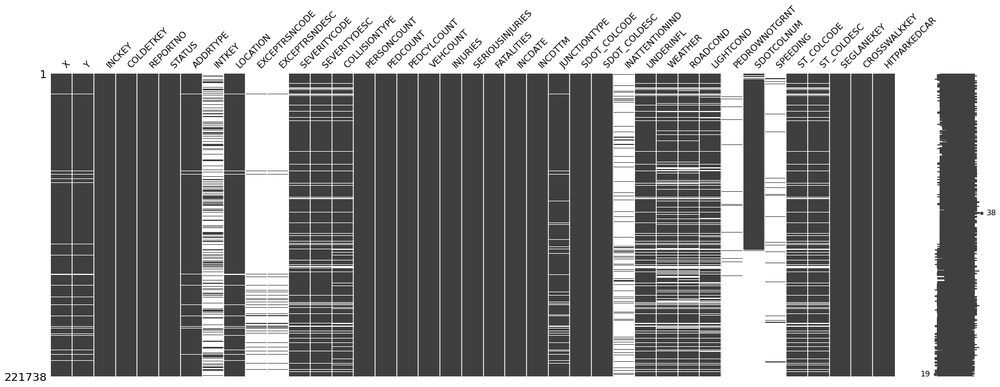

In [ ]:
#visualize missing values of datasets
import missingno as msno

#White lines in plots indicate missing values
msno.matrix(collision_df, figsize = (30, 10))

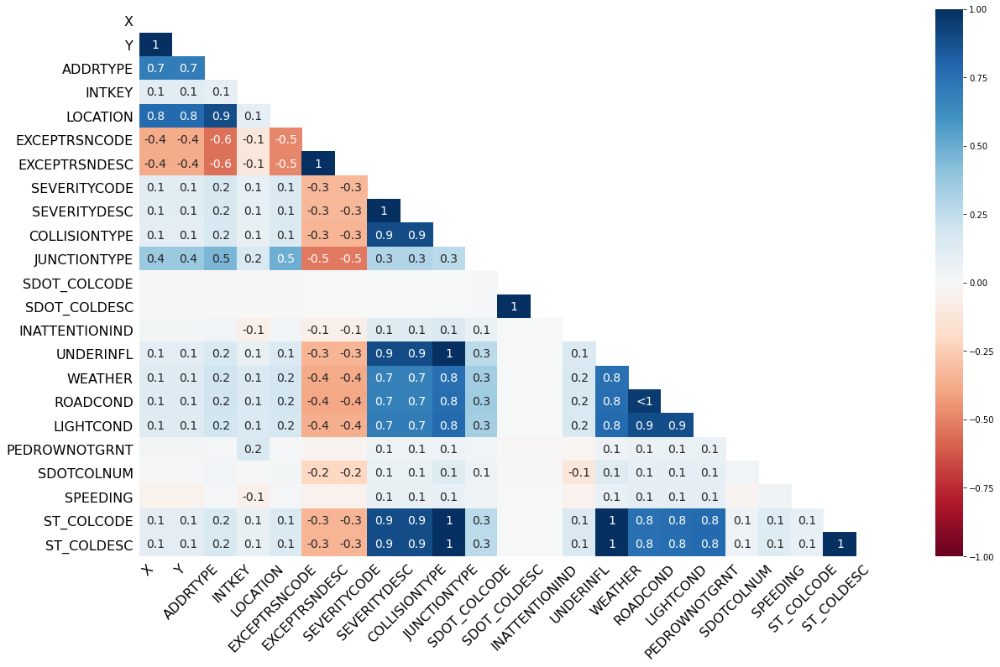

In [ ]:
#visualize correlation of missing values
msno.heatmap(collision_df)

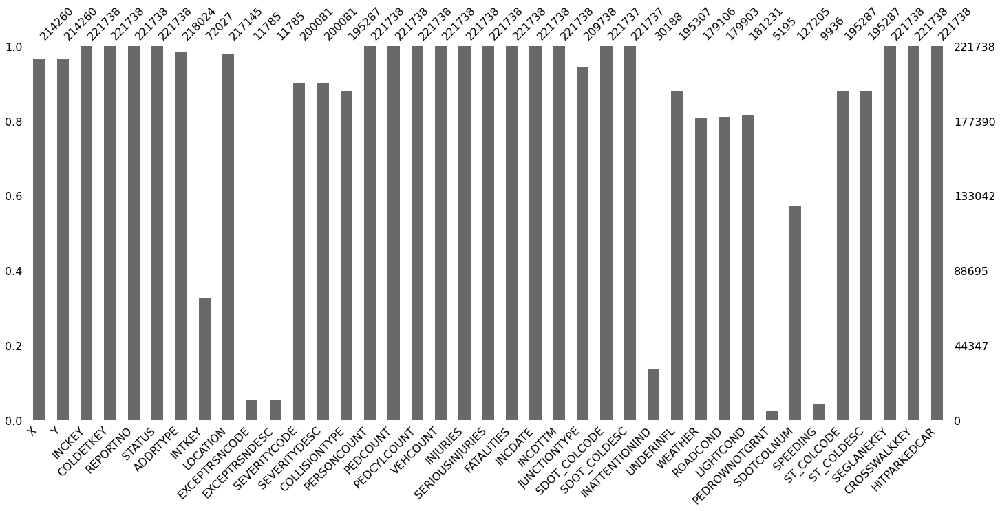

In [ ]:
#visualize missing values using bar, bar corresponds to features, number in bar top denotes "not missing data count"
msno.bar(collision_df)

# Deal With Missing Data    
References  
1. https://medium.com/@danberdov/types-of-missing-data-902120fa4248  
2. https://medium.com/@danberdov/dealing-with-missing-data-8b71cd819501  
3. FreeCodeCampOrg  
 - https://www.freecodecamp.org/news/the-penalty-of-missing-values-in-data-science-91b756f95a32/
**Strategy include:**  
1. Drop data  
 - drop whole row
 - drop whole column
2. replace data  
 - replace it by mean
 - replace it by frequency
 - replace it based on other functions (e.g. RBPR -> Random but proportional replacement)  

Columns should be dropped only if most entries in the column are empty.  

Replace by Mean:  
- "X"  
- "Y"  

Replace by Frequency:  
- "ADDRTYPE"  

Replace based on other function for categorical data:  
- "ADDRTYPE"  
- "LOCATION"    
- "COLLISIONTYPE"  
- "JUNCTIONTYPE"
- "UNDERINFL"
- "WEATHER"  
- "ROADCOND"  
- "LIGHTCOND"  
- "ST_COLDESC"
- "ST_COLCODE"

Drop the whole column:  
- INTKEY, EXCEPTRSNCODE, EXCEPTRSNDESC, INATTENTIONIND, PEDROWNOTGRNT, SDOTCOLNUM (contains most missing, variable not of interest), SPEEDING  

- Above variable contains high missing values, so dropping them might help.  
  1. INTKEY: 67.51% missing data  
  2. EXCEPTRSNCODE: 94.68% missing data  
  3. EXCEPTRSNDESC: 94.68% missing data  
  4. INATTENTIONIND: 86.38% missing data  
  5. PEDROWNOTGRNT: 97.65% missing data  
  6. SDOTCOLNUM: 42.63% missing data  
  7. SPEEDING: 95.51% missing data  
  

Drop the whole row:  
- "SEVERITYCODE": Target columns, simply delete row containing NaN values.  
  - Reason: "SEVERITYCODE" is what we want to predict. Any data entry without "SEVERITYCODE" cannot be used for prediction; therefore any row without "SEVERITYCODE" data is not useful.  



 




**Replace by mean**

In [ ]:
#Replace NaN values in "X" and "Y" columns by mean
collision_df["X"].replace(np.nan, collision_df["X"].mean(axis=0), inplace=True)
collision_df["Y"].replace(np.nan, collision_df["Y"].mean(axis=0), inplace=True)
collision_df.head(3)

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,-122.356511,47.517361,327920,329420,3856094,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,NaN,NaN,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0.0,Clear,Dry,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
2,-122.361405,47.702064,46200,46200,1791736,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,NaN,NaN,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0.0,Raining,Wet,Dusk,NaN,5101020.0,NaN,13,From same direction - both going straight - bo...,0,0,N
3,-122.317414,47.664028,1212,1212,3507861,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,NaN,NaN,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0.0,Clear,Dry,Dark - Street Lights On,NaN,NaN,NaN,30,From opposite direction - all others,0,0,N


**Replace based on other functions**

In [ ]:
#RBPR for categorical variable
"""
- Random but proportional replacement (RBPR)
  - In this method NaN values are filled based on the probability of non nan values
  - This approach is called soft imputation approach
  - NaN values are replaced by data radomly

-Advantage of this approach:
  1. Better data distribution
  2. Fairer approach, gives chance to all data values to be a part of missing values, based on proportion
  3. Mean is conserved for numeric data, after filling NaN values. For categorical data, mode is conserved.
  4. Chances of model overfitting is lesser, compared to hard imputation approach
"""
valueCounts = {}
df = collision_df.copy()
def CountAll():
    global all_columns, nanCounts, valueCounts
    all_columns = list(df) #gives list of columns
    nanCounts = df.isnull().sum()
    for x in all_columns:
        valueCounts[x] = df[x].value_counts()        
"""-------------------------------------------------------------------------"""

def Fill_NaNs_Catigorical(col): 
    """Calculating probability and expected value."""
    proportion = np.array(valueCounts[col].values) / valueCounts[col].sum() * nanCounts[col]
    proportion = np.around(proportion).astype('int')
    
    """Adjusting proportion."""
    diff = int(nanCounts[col] - np.sum(proportion))
    if diff > 0:
        for x in range(diff):
            idx = random.randint(0, len(proportion) - 1)
            proportion[idx] =  proportion[idx] + 1
    else:
        diff = -diff
        while(diff != 0):
            idx = random.randint(0, len(proportion) - 1)
            if proportion[idx] > 0:
                proportion[idx] =  proportion[idx] - 1
                diff = diff - 1
        
    """Filling NaNs."""
    nan_indexes = df[df[col].isnull()].index.tolist() 
    for x in range(len(proportion)):
        if proportion[x] > 0:
            random_subset = random.sample(population = nan_indexes, k = proportion[x])
            df.loc[random_subset, col] = valueCounts[col].keys()[x]
            nan_indexes = list(set(nan_indexes) - set(random_subset))

#count unique values in dataframe
CountAll()

#list of categorical variable, whose NaN values to be filled
categorical_list = ["ADDRTYPE", "LOCATION", "COLLISIONTYPE", "JUNCTIONTYPE", "UNDERINFL", "WEATHER", "ROADCOND", "LIGHTCOND", "ST_COLDESC", "ST_COLCODE"]

#fill NaNs values
for column in categorical_list:
  Fill_NaNs_Catigorical(column)

#copy dataframe after replace NaN
collision_df = df.copy()

In [ ]:
#verify non nan values
print("nan values are:")
collision_df[categorical_list].isna().sum()

nan values are:


ADDRTYPE         0
LOCATION         0
COLLISIONTYPE    0
JUNCTIONTYPE     0
UNDERINFL        0
WEATHER          0
ROADCOND         0
LIGHTCOND        0
ST_COLDESC       0
ST_COLCODE       0
dtype: int64

**Drop the whole column**

In [ ]:
#Drop the whole column, containing most number of missing fields
collision_df.drop(["INTKEY", "EXCEPTRSNCODE", "EXCEPTRSNDESC", "INATTENTIONIND", "PEDROWNOTGRNT", "SDOTCOLNUM", "SPEEDING"], axis=1, inplace=True)
collision_df.head(3)

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,LOCATION,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,-122.356511,47.517361,327920,329420,3856094,Matched,Intersection,17TH AVE SW AND SW ROXBURY ST,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",0.0,Clear,Dry,Daylight,10,Entering at angle,0,0,N
2,-122.361405,47.702064,46200,46200,1791736,Matched,Block,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",0.0,Raining,Wet,Dusk,13,From same direction - both going straight - bo...,0,0,N
3,-122.317414,47.664028,1212,1212,3507861,Matched,Block,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",0.0,Clear,Dry,Dark - Street Lights On,30,From opposite direction - all others,0,0,N


**Drop the whole row**

In [ ]:
#drop whole row, with target column "SEVERITYCODE" containing nan values
collision_df.dropna(axis=0, subset=["SEVERITYCODE"], inplace=True)
collision_df.isna().sum()

X                  0
Y                  0
INCKEY             0
COLDETKEY          0
REPORTNO           0
STATUS             0
ADDRTYPE           0
LOCATION           0
SEVERITYCODE       0
SEVERITYDESC       0
COLLISIONTYPE      0
PERSONCOUNT        0
PEDCOUNT           0
PEDCYLCOUNT        0
VEHCOUNT           0
INJURIES           0
SERIOUSINJURIES    0
FATALITIES         0
INCDATE            0
INCDTTM            0
JUNCTIONTYPE       0
SDOT_COLCODE       0
SDOT_COLDESC       0
UNDERINFL          0
WEATHER            0
ROADCOND           0
LIGHTCOND          0
ST_COLCODE         0
ST_COLDESC         0
SEGLANEKEY         0
CROSSWALKKEY       0
HITPARKEDCAR       0
dtype: int64

Finally, we have handled missing datasets, let's visualize it using missingno library

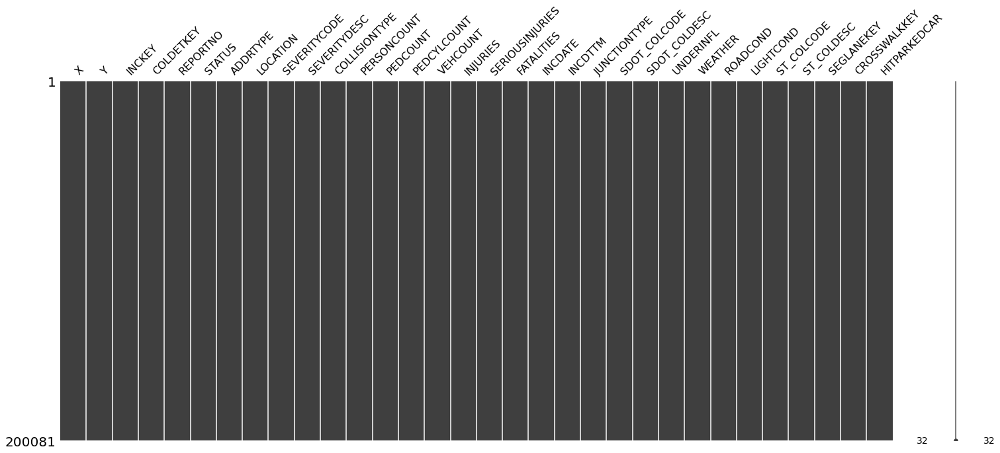

In [ ]:
#visualize data using missingno library
msno.matrix(collision_df)

Good, now we obtain the datasets with no mising values  

Now, let's reset_index, which is not in order as different rows are deleted.  

In [ ]:
#reset index
collision_df.reset_index(drop=True, inplace=True)
collision_df.head(3)

,X,Y,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,LOCATION,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,-122.356511,47.517361,327920,329420,3856094,Matched,Intersection,17TH AVE SW AND SW ROXBURY ST,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",0.0,Clear,Dry,Daylight,10,Entering at angle,0,0,N
1,-122.361405,47.702064,46200,46200,1791736,Matched,Block,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",0.0,Raining,Wet,Dusk,13,From same direction - both going straight - bo...,0,0,N
2,-122.317414,47.664028,1212,1212,3507861,Matched,Block,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",0.0,Clear,Dry,Dark - Street Lights On,30,From opposite direction - all others,0,0,N


# Correct Data Format  
We are almost in end of data cleaning!  
The last step in data cleaning is checking and making sure that all data is in the correct format(int, float, text or other)

In [ ]:
#check dtypes
collision_df.dtypes

X                  float64
Y                  float64
INCKEY               int64
COLDETKEY            int64
REPORTNO            object
STATUS              object
ADDRTYPE            object
LOCATION            object
SEVERITYCODE        object
SEVERITYDESC        object
COLLISIONTYPE       object
PERSONCOUNT          int64
PEDCOUNT             int64
PEDCYLCOUNT          int64
VEHCOUNT             int64
INJURIES             int64
SERIOUSINJURIES      int64
FATALITIES           int64
INCDATE             object
INCDTTM             object
JUNCTIONTYPE        object
SDOT_COLCODE       float64
SDOT_COLDESC        object
UNDERINFL          float64
WEATHER             object
ROADCOND            object
LIGHTCOND           object
ST_COLCODE          object
ST_COLDESC          object
SEGLANEKEY           int64
CROSSWALKKEY         int64
HITPARKEDCAR        object
dtype: object

From above, we can conclude that some columns are not of the correct data type. Numerical variables should have type 'float' or 'int', categorical variables should have type 'object' and Date Time variable should have correspoding datatime format.  

For example:  
Correction needed for:  
1. ST_COLCODE: Convert object type into correspoding int or float   
1. INCDTTM: Convert object type into corresponding datetime format    
2. INCDATE: Convert object type into corresponding datetime format   


In [ ]:
#convert ST_COLCODE from type "object" to "float"
collision_df[["ST_COLCODE"]] = collision_df["ST_COLCODE"].astype("float")
collision_df[["ST_COLCODE"]].dtypes

ST_COLCODE    float64
dtype: object

Here, **STCOLCODE** is converted to _float_ 

Now, its time to convert variable **"INCDATE"**, **"INCDTTM"** from _object_ type to correspoding _datetime_ format.  

In [ ]:
#convert INCDATE to datetime object

#add each converted datetime object into list
INCDATE_TIMESTAMP = [pd.to_datetime(item) for item in collision_df["INCDATE"]]

#replace INCDATE values from original dataframe
collision_df["INCDATE"] = INCDATE_TIMESTAMP

#check values and dtypes
collision_df.INCDATE.head()

0   2020-01-19 00:00:00+00:00
1   2005-04-11 00:00:00+00:00
2   2013-03-31 00:00:00+00:00
3   2020-01-06 00:00:00+00:00
4   2009-12-25 00:00:00+00:00
Name: INCDATE, dtype: datetime64[ns, UTC]

From above, it is verified that, **INCDATE** is converted to _timestamp_ from _object_ type.  

Now, let's convert **INCDTTM** to _datetime_ object   

In [ ]:
# Function to convert the date format from 12 hour format to 24 hour format 

def convert24(str1): 
  try:      
    # Checking if last two elements of time 
    # is AM and first two elements are 12 
    if str1[-2:] == "AM" and str1[:2] == "12": 
        return "00" + str1[2:-2] 
          
    # remove the AM     
    elif str1[-2:] == "AM": 
        return str1[:-2] 
      
    # Checking if last two elements of time 
    # is PM and first two elements are 12    
    elif str1[-2:] == "PM" and str1[:2] == "12": 
        return str1[:-2] 
          
    else: 
          
        # add 12 to hours and remove PM 
        return str(int(str1[:2]) + 12) + str1[2:8] 
  
  except ValueError:
    str1 = "0"+str1
    # Checking if last two elements of time 
    # is AM and first two elements are 12 
    if str1[-2:] == "AM" and str1[:2] == "12": 
      return "00" + str1[2:-2] 
          
    # remove the AM     
    elif str1[-2:] == "AM": 
      return str1[:-2] 
      
    # Checking if last two elements of time 
    # is PM and first two elements are 12    
    elif str1[-2:] == "PM" and str1[:2] == "12": 
      return str1[:-2] 
          
    else: 
          
      # add 12 to hours and remove PM 
      return str(int(str1[:2]) + 12) + str1[2:8] 
        

In [ ]:
#Convert INCDTTM values into date_time format, and append it to variable "dateTimeStamp_list" 
dateTimeStamp_list = []
for row in range(collision_df.shape[0]):
  date_time = collision_df.loc[row, "INCDTTM"]
  date_time_split = date_time.split(" ")
  date = date_time_split[0]
  try:
    time = date_time_split[1]+" "+date_time_split[2]

    #convert to 24 hour format
    time = convert24(time)

  except IndexError:
    time= ""
  date_time = date+" "+time
  date_time = pd.to_datetime(date_time)
  dateTimeStamp_list.append(date_time)

#date_time.time(), date_time.date()

In [ ]:
# Finally, Impute dateTimeStamp_list to original "INCDTTM" variable of pandas dataframe
collision_df["INCDTTM"] = dateTimeStamp_list

#check first 5 values
collision_df["INCDTTM"].head()

0   2020-01-19 09:01:00
1   2005-04-11 18:31:00
2   2013-03-31 02:09:00
3   2020-01-06 17:55:00
4   2009-12-25 19:00:00
Name: INCDTTM, dtype: datetime64[ns]

This shows that, **INCDTTM** is converted from _object_ type to _datetime64_ type  

Now, let's extract separate **date** and **time** from **INCDTTM** and add it to Dataframe named **collision_df** using variable named **INCDATE** for **date** and **INCTIME** for **time**

In [ ]:
#extract date and time from INCDTTM, and append, date to inc_date list, and time to inc_time list 
collision_df["INCTIME"] = np.nan
inc_time = []
inc_date = []
for row in range(collision_df.shape[0]):
  inc_time.append(collision_df.loc[row, "INCDTTM"].time()) 
  inc_date.append(collision_df.loc[row, "INCDTTM"].date()) 

In [ ]:
#now add date and time for each collision in original dataframe
collision_df["INCTIME"] = inc_time
collision_df["INCDATE"] = inc_date
collision_df[["INCDATE", "INCTIME"]].head()

,INCDATE,INCTIME
0,2020-01-19,09:01:00
1,2005-04-11,18:31:00
2,2013-03-31,02:09:00
3,2020-01-06,17:55:00
4,2009-12-25,19:00:00


From above dataframe, it can be seen that new variable **INCTIME** has been added with time for each collision, and variable **INCDATE** has been replace with date in which collision occur  



On exploring further, The features **LIGHTCOND** contains two values which means the same i.e  
- Dark - No Street Lights  
- Dark - Street Lights Off  

Let's, replace  **Dark - No Street Lights** by **Dark - Street Lights Off** 

In [ ]:
#Replace values
print("****Unique values before Replacing****\n", collision_df["LIGHTCOND"].unique())

collision_df["LIGHTCOND"].replace("Dark - No Street Lights", "Dark - Street Lights Off", inplace=True)

print("****Unique values after Replacing****\n", collision_df["LIGHTCOND"].unique())

****Unique values before Replacing****
 ['Daylight' 'Dusk' 'Dark - Street Lights On' 'Dark - Unknown Lighting'
 'Dawn' 'Dark - No Street Lights' 'Dark - Street Lights Off']
****Unique values after Replacing****
 ['Daylight' 'Dusk' 'Dark - Street Lights On' 'Dark - Unknown Lighting'
 'Dawn' 'Dark - Street Lights Off']


# Data Normalization:  
References:  
https://medium.com/towards-artificial-intelligence/how-when-and-why-should-you-normalize-standardize-rescale-your-data-3f083def38ff   

Technically, normalization is performed after train test split

Note:   
- Algorithm based on recursive partitioning, such as decision trees, and regression trees does not require inputs (features) to be normalized.  
- Also, random forest is also just the collection of decision trees, so no need to normalize.  
- Normalizations helps to algorithm such as distance based(k-nearest neighbours), neural networks etc.  
- For tree-based models normalizing data gives same result as that of un normalized data.  

# Binning  
Now, let us convert time i.e variable "INCTIME" into four category for grouped analysis as follows:  
- 00:00:00-6:00:00 -> **Early Morning**  
- 06:00:00-12:00:00 -> **Morning**
- 12:00:00-18:00:00 -> **Afternoon**
- 00:00:00-6:00:00 -> **Evening**
- 00:00:00-6:00:00 -> **Night**

In [ ]:
#define time range
time_range = {
    "time1": pd.to_datetime("00:00:00").time(),
    "time2": pd.to_datetime("06:00:00").time(),
    "time3": pd.to_datetime("12:00:00").time(),
    "time4": pd.to_datetime("18:00:00").time(),
    "time5": pd.to_datetime("21:00:00").time(), 
}

In [ ]:
#append time category to list
time_category = []
for row in range(collision_df.shape[0]):
  time = collision_df.loc[row, "INCTIME"]
  if time>time_range["time1"] and time<=time_range["time2"]:
    time_category.append("Early morning")
  elif time>time_range["time2"] and time<=time_range["time3"]:
    time_category.append("Morning")
  elif time>time_range["time3"] and time<=time_range["time4"]:
    time_category.append("Afternoon")
  elif time>time_range["time4"] and time<=time_range["time5"]:
    time_category.append("Evening")
  else:
    time_category.append("Night")

Now, let us add all the time category corresponding to each collision, creating a new variable named **INCTIME-BINNED** to original dataframe

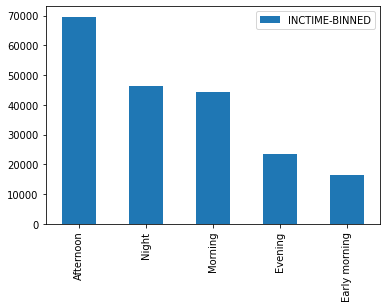

In [ ]:
#adding time_category to dataframe
collision_df["INCTIME-BINNED"] = time_category

#visualize time_category count
collision_df["INCTIME-BINNED"].value_counts().to_frame().plot(kind='bar')

Finally, new variable is added which includes category of time at which collision occured.  

Next, Let's extract day on which collision occur using **INCDATE** variable, and make category as:  
1. **Monday**: Begining of week  
2. **Tuesday**, **Wednesday**, **Thursday**: Weekday  
3. **Friday**: End of week  
4. **Saturday**, **Sunday**: Weekend

In [ ]:
def convert_day_to_category(row):
  """
  extract day from dataframe using row passed as argument, and group extracted day into category  

  Arguments:  
  row: Row of the dataframe

  Returns:
  Category in which corresponding day is assigned to
  """
  day = collision_df.loc[row, "INCDATE"].strftime("%A")
  if day == "Monday":
    return "Begining of week"
  elif (day in ["Tuesday", "Wednesday", "Thursday"]):
    return "Weekday"
  elif (day == "Friday"):
    return "End of week"
  else:
    return "Weekend"

#list of rows of dataframe
rowNum_list = list(range(collision_df.shape[0]))

#convert day into category, and add to list for all rows in dataframe
day_category_list = list(map(convert_day_to_category , rowNum_list))

Now, all of the day corresponding to the collisions are converted into categories.   

Lets add it to the original dataframe by creating new variable named **DAYOFWEEK**

In [ ]:
#add categories to dataframe
collision_df["DAYOFWEEK"] = day_category_list

#count collision according to DAYOFWEEK
collision_df["DAYOFWEEK"].value_counts().to_frame()

,DAYOFWEEK
Weekday,89082
Weekend,50702
End of week,33231
Begining of week,27066


Finally, we have obtained the cleaned form of data, let's save it for later use.

In [ ]:
#mount google drive
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
#save data
PATH = "/content/gdrive/My Drive/IBM_capstone_project/"
collision_df.to_csv(PATH+"clean_df.csv")